# Start to end test

In [1]:
# Specify device
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0" 
os.environ["TF_FORCE_GPU_ALLOW_GROWTH"]="true"

Before runing this test, please download models from [https://nomeroff.net.ua/models/](https://nomeroff.net.ua/models/) to **./models/** directory. 

In [2]:
# Import all necessary libraries.
import numpy as np
import sys
import glob
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
from termcolor import colored

plt.rcParams["figure.figsize"] = (10,10)

In [3]:
# NomeroffNet path
NOMEROFF_NET_DIR = os.path.abspath('../')
sys.path.append(NOMEROFF_NET_DIR)

In [4]:
from NomeroffNet.BBoxNpPoints import NpPointsCraft, getCvZoneRGB, convertCvZonesRGBtoBGR, reshapePoints
#from NomeroffNet.BBoxNpPoints import NpPointsCraft
npPointsCraft = NpPointsCraft()
npPointsCraft.load()

/usr/local/lib64/python3.8/site-packages/torch/cuda/__init__.py:52: UserWarning: CUDA initialization: Found no NVIDIA driver on your system. Please check that you have an NVIDIA GPU and installed a driver from http://www.nvidia.com/Download/index.aspx (Triggered internally at  /pytorch/c10/cuda/CUDAFunctions.cpp:100.)
  return torch._C._cuda_getDeviceCount() > 0


Loading weights from checkpoint (/mnt/data/var/www/nomeroff-net/NomeroffNet/Base/mcm/./models/NpPointsCraft/mtl/craft_mlt_25k_2020-02-16.pth)
Loading weights of refiner from checkpoint (/mnt/data/var/www/nomeroff-net/NomeroffNet/Base/mcm/./models/NpPointsCraft/refiner/craft_refiner_CTW1500_2020-02-16.pth )


In [5]:
from NomeroffNet.YoloV5Detector import Detector

detector = Detector()
detector.load()

In [6]:
from NomeroffNet.OptionsDetector import OptionsDetector

optionsDetector = OptionsDetector()
optionsDetector.load()

In [7]:
from NomeroffNet.TextDetector import TextDetector
textDetector = TextDetector({
    "eu_ua_2004_2015": {
        "for_regions": ["eu_ua_2015", "eu_ua_2004"],
        "model_path": "latest"
    },
    "eu_ua_1995": {
        "for_regions": ["eu_ua_1995"],
        "model_path": "latest"
    },
    "eu": {
        "for_regions": ["eu"],
        "model_path": "latest"
    },
    "ru": {
        "for_regions": ["ru", "eu-ua-fake-lnr", "eu-ua-fake-dnr"],
        "model_path": "latest" 
    },
    "kz": {
        "for_regions": ["kz"],
        "model_path": "latest"
    },
    "ge": {
        "for_regions": ["ge"],
        "model_path": "latest"
    },
    "su": {
        "for_regions": ["su"],
        "model_path": "latest"
    }
})

In [8]:
import cv2
import numpy as np

async def test(dirName, fname, y, min_bbox_acc = 0.5, verbose=0):
    nGood = 0
    nBad  = 0
    img_path = os.path.join(dirName, fname)
    if verbose==1:
        print(colored(f"__________ \t\t {img_path} \t\t __________", "blue"))
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    targetBoxes = detector.detect_bbox(img)
    
    all_points = npPointsCraft.detect(img, targetBoxes,[5,2,0])
    # for  images/14.jpeg bug
    all_points = [ps for ps in all_points if len(ps)]
    
    print('all_points')
    print(all_points)
    # cut zones
    toShowZones = [getCvZoneRGB(img, reshapePoints(rect,1)) for rect in all_points]
    zones = convertCvZonesRGBtoBGR(toShowZones)    

    # find standart
    regionIds, countLines = optionsDetector.predict(zones)
    regionNames = optionsDetector.getRegionLabels(regionIds)
    print(regionNames)
    print(countLines)
    
    for zone, points in zip(toShowZones, all_points):
        plt.axis("off")
        plt.imshow(zone)
        plt.show()

    # find text with postprocessing by standart  
    textArr = textDetector.predict(zones, regionNames, countLines)
    print(textArr)
    
     # draw rect and 4 points
    for targetBox, points in zip(targetBoxes, all_points):
        # draw 
        cv2.rectangle(img, 
                      (int(targetBox[0]), int(targetBox[1])), 
                      (int(targetBox[2]), int(targetBox[3])), 
                      (0,120,255), 
                      3)
        #print(points, points.shape)
        cv2.polylines(img, np.array([points], np.int32), True, (255,120,255),3)
    plt.imshow(img)
    plt.show()

    for yText in y:
        if yText in textArr:
            print(colored(f"OK: TEXT:{yText} \t\t\t RESULTS:{textArr} \n\t\t\t\t\t in PATH:{img_path}", 'green'))
            nGood += 1
        else:
            print(colored(f"NOT OK: TEXT:{yText} \t\t\t RESULTS:{textArr} \n\t\t\t\t\t in PATH:{img_path} ", 'red'))
            nBad += 1
    return nGood, nBad

In [9]:
dirName = "./images"

__________ 		 ./images/0.jpeg 		 __________
all_points
[[[201.62832046568082, 313.97644842352867], [201.0, 279.4181812743712], [372.3716748051453, 276.3023351239853], [373.0, 310.8606031022712]]]
['eu_ua_2015']
[1]


/mnt/data/var/www/nomeroff-net/NomeroffNet/Base/nnmodels.py:45: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  x1 = functional.softmax(self.fc3_reg(x1))
/mnt/data/var/www/nomeroff-net/NomeroffNet/Base/nnmodels.py:52: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  x2 = functional.softmax(self.fc3_line(x2))


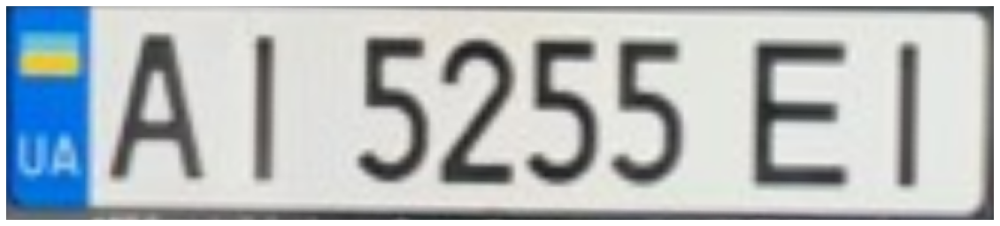

['AI5255EI']


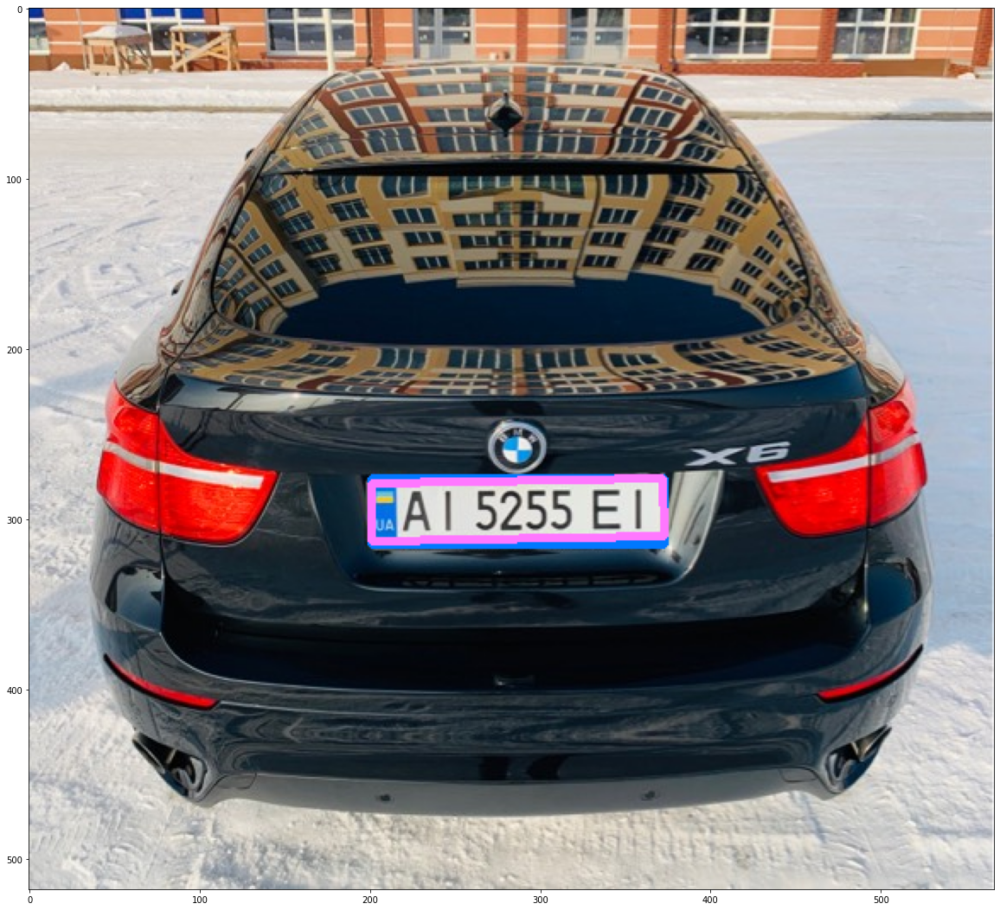

OK: TEXT:AI5255EI 			 RESULTS:['AI5255EI'] 
					 in PATH:./images/0.jpeg
__________ 		 ./images/1.jpeg 		 __________
all_points
[[[42.269320783140415, 520.9721033079308], [38.61321333337152, 480.9211066729087], [91.37406580376947, 528.885506506588], [95.03017003607425, 568.9365111630898]]]
['eu_ua_2015']
[1]


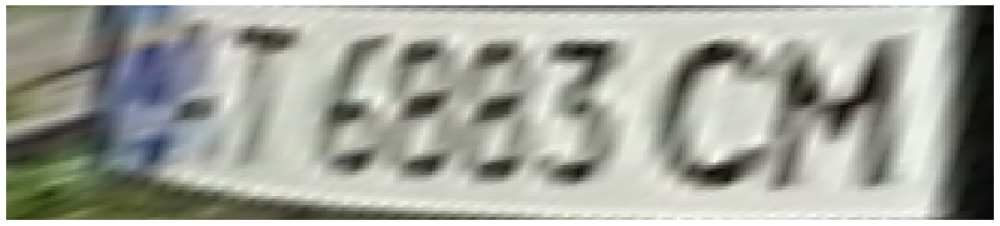

['AT6883CM']


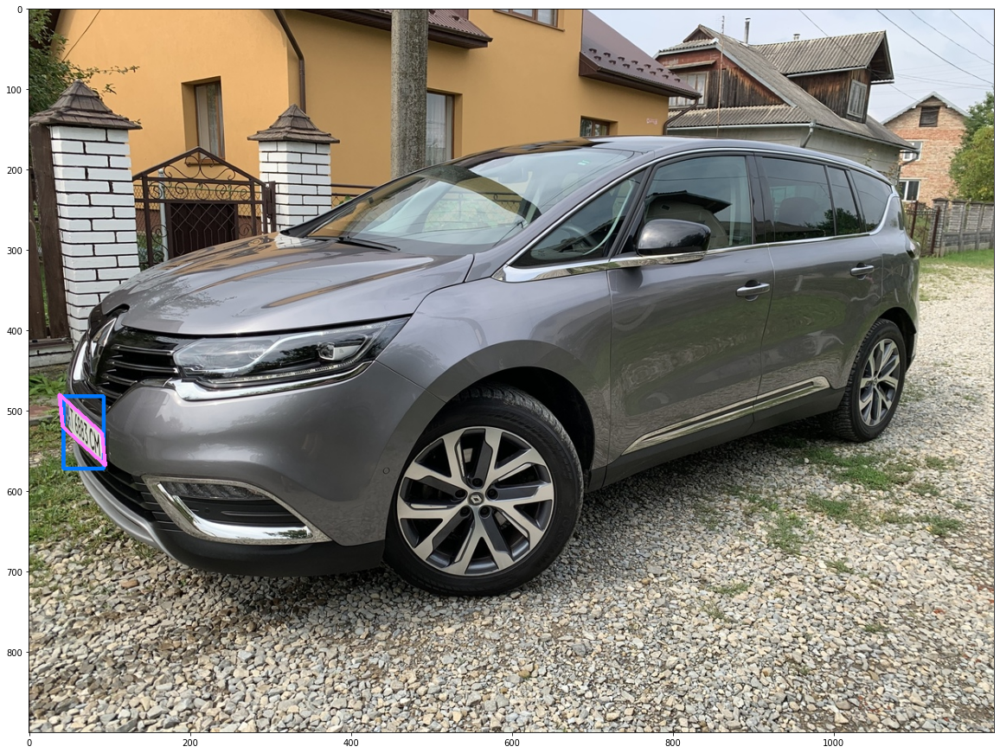

OK: TEXT:AT6883CM 			 RESULTS:['AT6883CM'] 
					 in PATH:./images/1.jpeg
__________ 		 ./images/2.jpeg 		 __________
all_points
[[[2800.5519534523423, 1722.9924363834725], [2809.626102071266, 1593.0986207380836], [3200.4829395487914, 1426.9844229214214], [3191.408814061928, 1556.8782505218978]], [[2457.0, 560.0533348973592], [2457.000001182556, 531.9466617250441], [2566.0, 531.9466568523645], [2566.0, 560.0533305660883]]]
['eu_ua_2015', 'eu']
[1, 1]


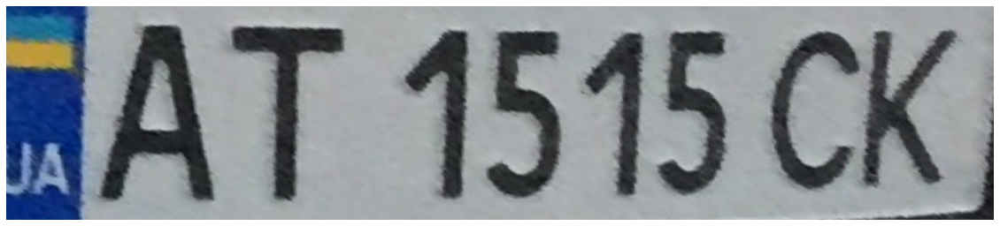

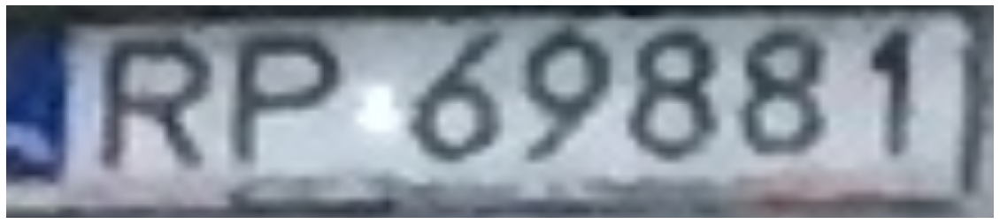

['AT1515CK', 'RP69881']


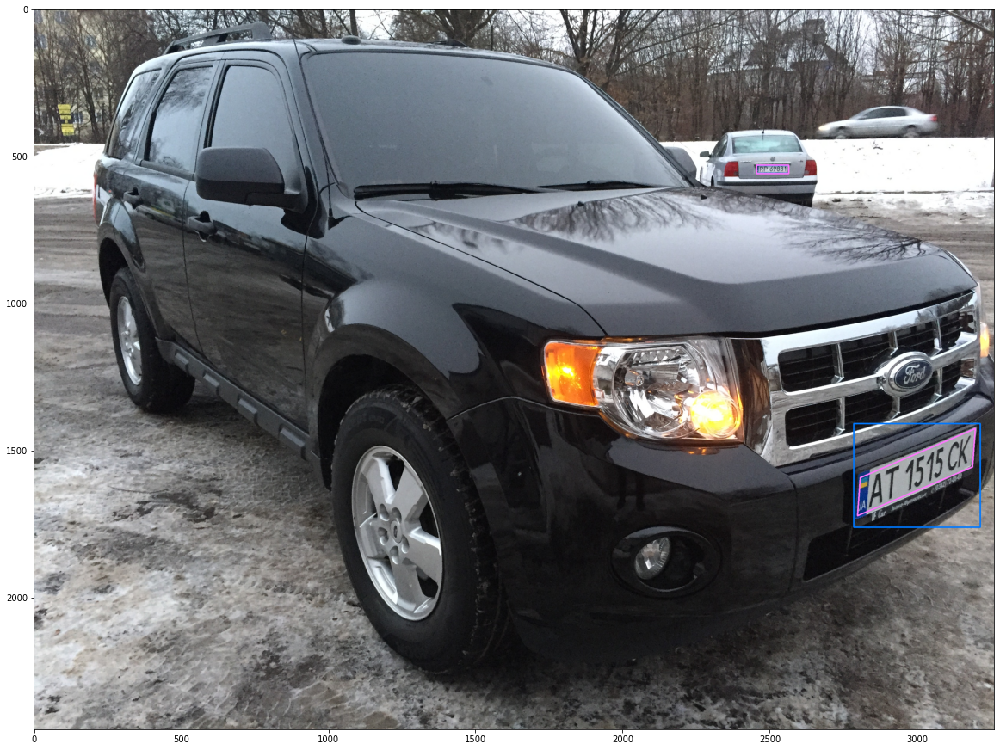

OK: TEXT:AT1515CK 			 RESULTS:['AT1515CK', 'RP69881'] 
					 in PATH:./images/2.jpeg
__________ 		 ./images/3.jpeg 		 __________
all_points
[[[912.1550030508856, 663.5715437127758], [912.1550030508855, 630.0289769180956], [996.9268344243794, 590.9035084543258], [996.9268261524178, 624.4460787332318]]]
['eu_ua_2015']
[1]


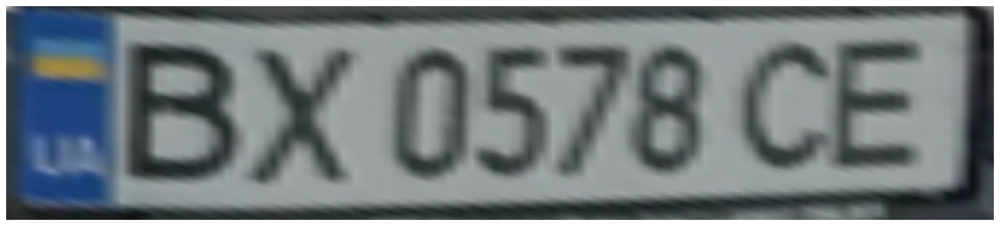

['BX0578CE']


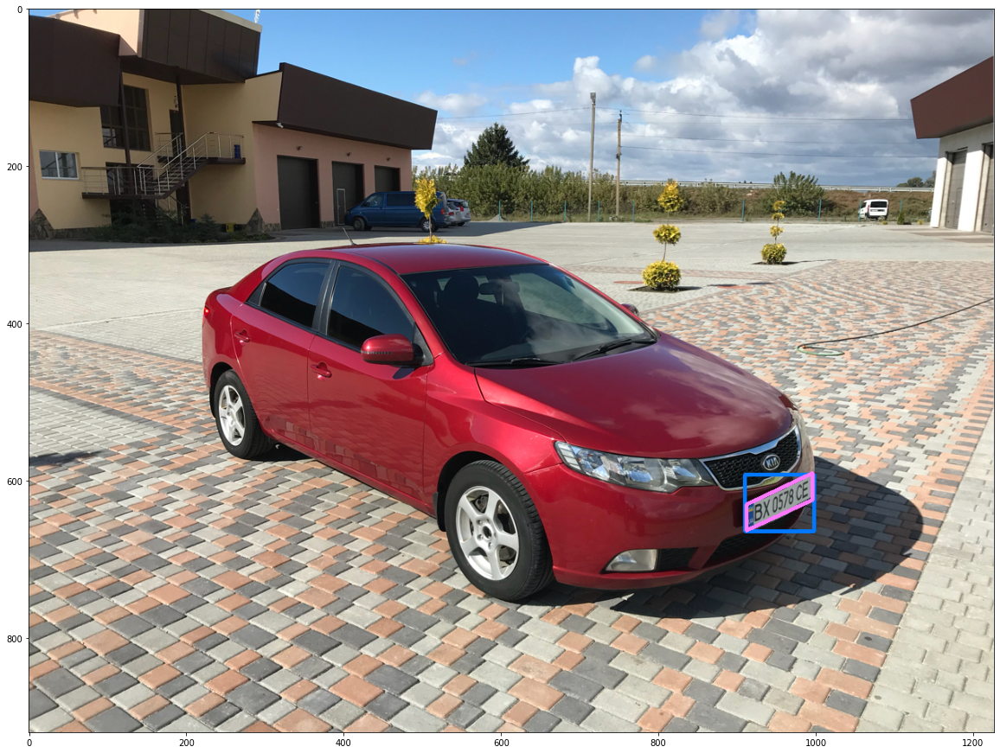

OK: TEXT:BX0578CE 			 RESULTS:['BX0578CE'] 
					 in PATH:./images/3.jpeg
__________ 		 ./images/4.jpeg 		 __________
all_points
[[[1119.1493395691245, 895.1661061566775], [1119.7240093536873, 846.1158322199864], [1337.85066279558, 833.2848742817483], [1337.2759906463127, 882.335148225369]]]
['eu_ua_2015']
[1]


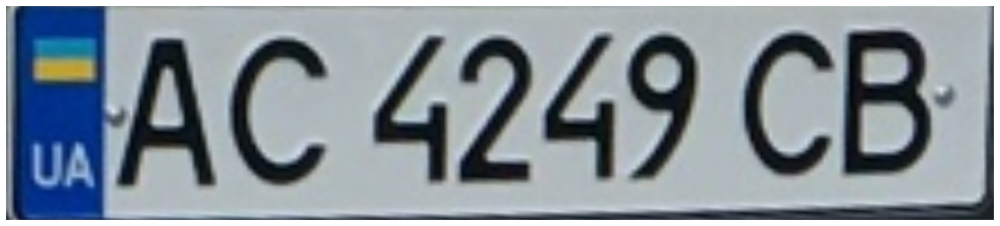

['AC4249CB']


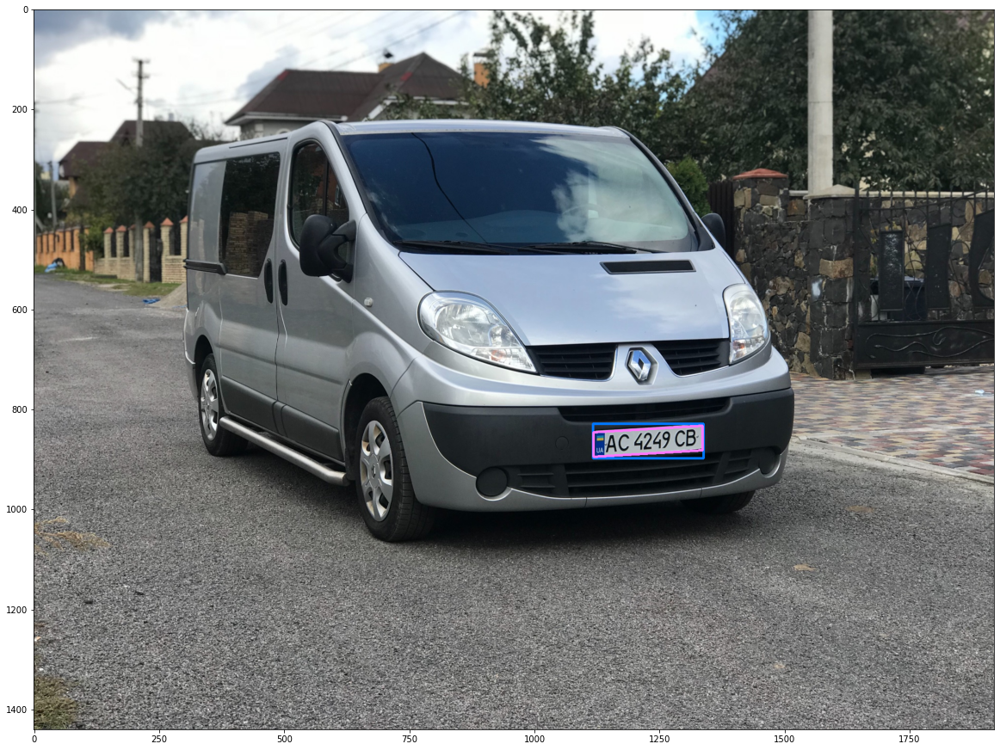

OK: TEXT:AC4249CB 			 RESULTS:['AC4249CB'] 
					 in PATH:./images/4.jpeg
__________ 		 ./images/5.jpeg 		 __________
all_points
[[[609.4245413166981, 1656.5978615197034], [626.3314838185881, 1554.4507765194242], [899.36435249937, 1632.2133085480646], [882.4574345153511, 1734.360395855844]]]
['eu_ua_2015']
[1]


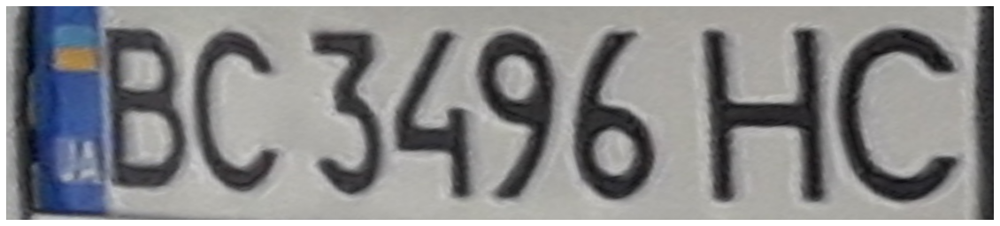

['BC3496HC']


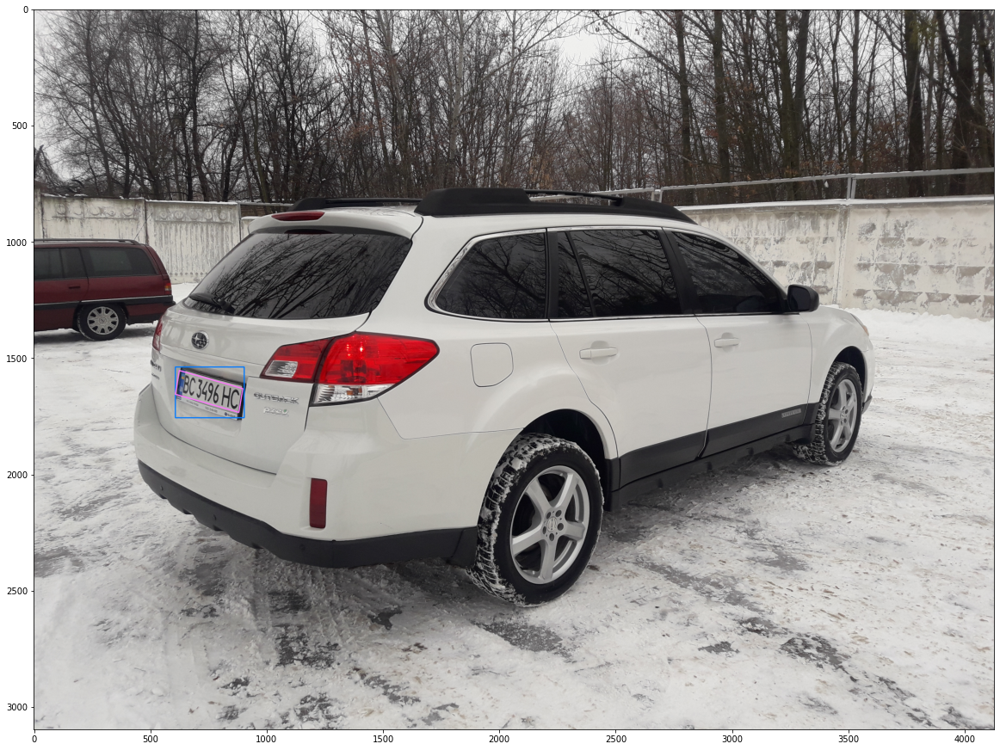

OK: TEXT:BC3496HC 			 RESULTS:['BC3496HC'] 
					 in PATH:./images/5.jpeg
__________ 		 ./images/6.jpeg 		 __________
all_points
[[[3352.3874004952254, 1806.6774908703476], [3341.924933663484, 1679.1235084961343], [3645.1317940150466, 1531.0456934628721], [3655.5942798468877, 1658.599683919298]]]
['eu_ua_2015']
[1]


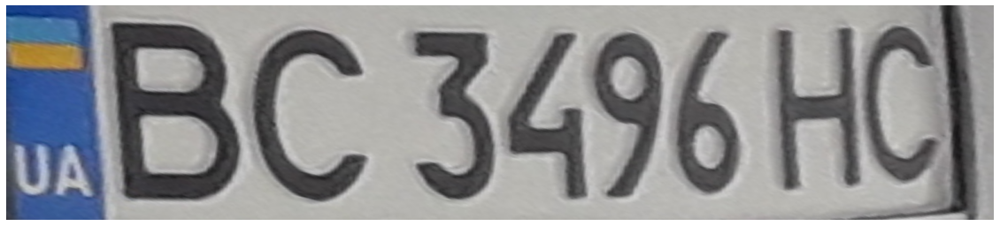

['BC3496HC']


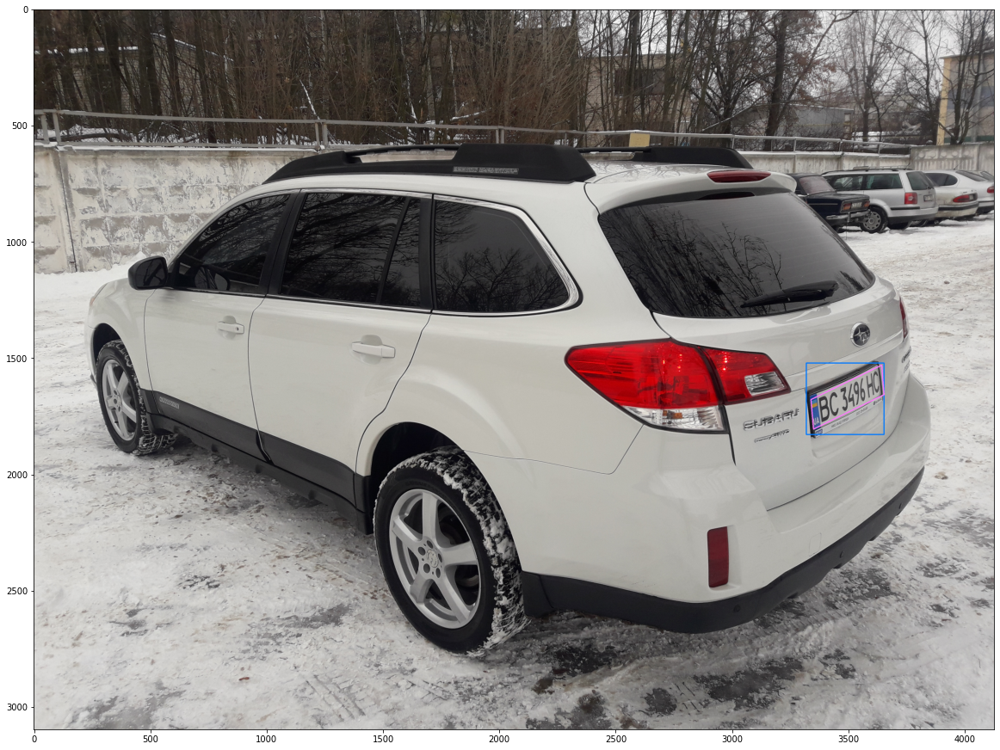

OK: TEXT:BC3496HC 			 RESULTS:['BC3496HC'] 
					 in PATH:./images/6.jpeg
__________ 		 ./images/7.jpeg 		 __________
all_points
[[[113.21396878386673, 734.1963391510417], [107.94884376451431, 674.5249567770135], [365.78603121613327, 735.9147738621499], [371.05117278361644, 795.5861598159984]]]
['eu_ua_2015']
[1]


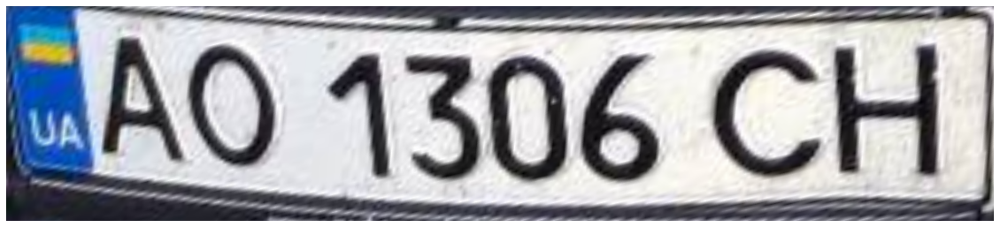

['AO1306CH']


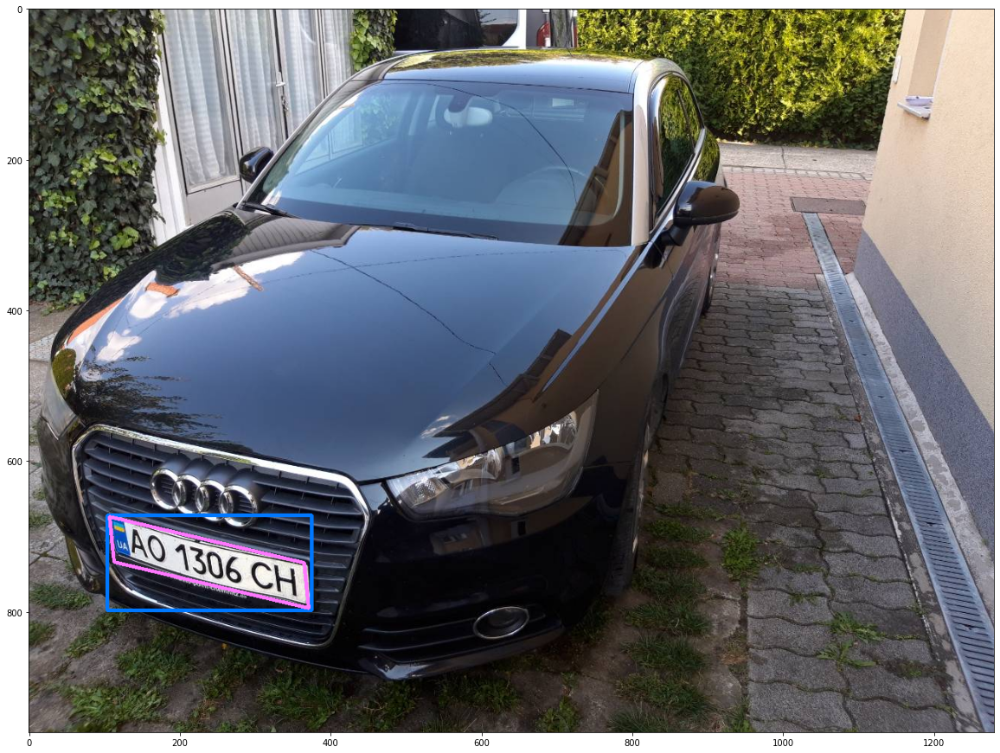

OK: TEXT:AO1306CH 			 RESULTS:['AO1306CH'] 
					 in PATH:./images/7.jpeg
__________ 		 ./images/8.jpeg 		 __________
all_points
[[[1067.6630589879828, 975.19516995814], [1069.880470971959, 902.5322934079369], [1413.336912622936, 876.1125242571454], [1411.119529028041, 948.7753973602148]]]
['eu_ua_2004']
[1]


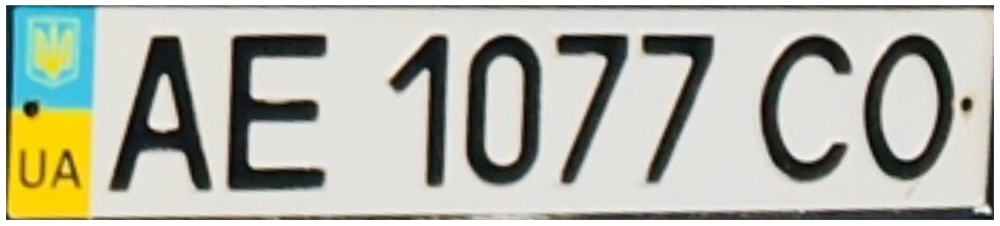

['AE1077CO']


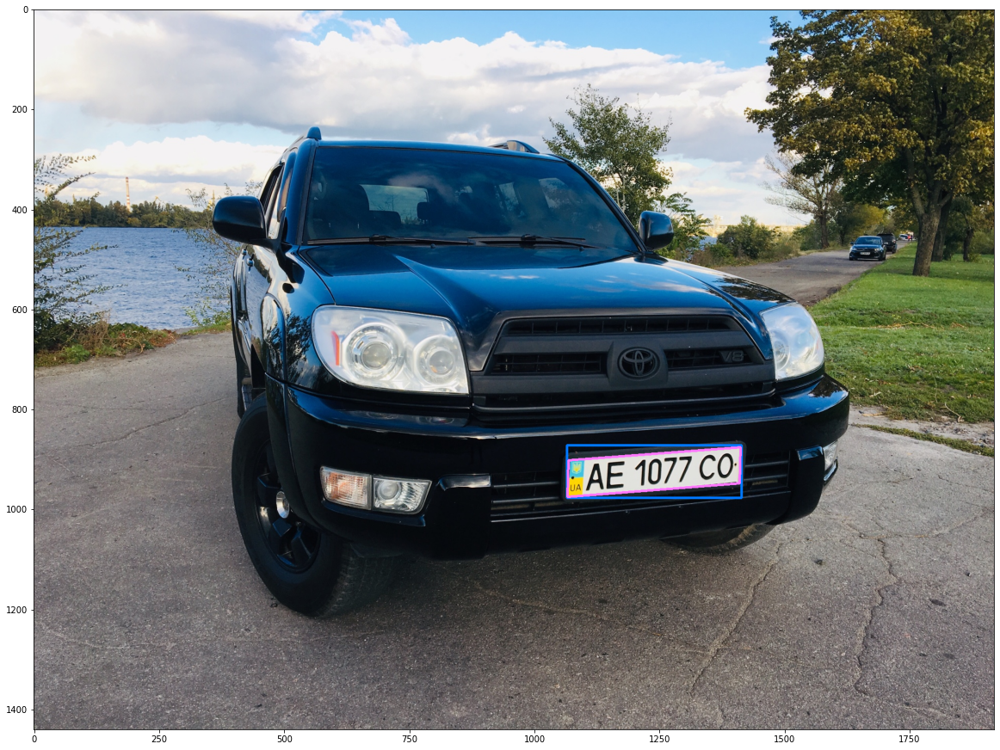

OK: TEXT:AE1077CO 			 RESULTS:['AE1077CO'] 
					 in PATH:./images/8.jpeg
__________ 		 ./images/9.jpeg 		 __________
all_points
[[[969.8032640104503, 857.8846240952731], [967.0585417187644, 812.6494515335944], [1158.1709709179831, 783.247535116208], [1160.9156836974744, 828.4827120717645]]]
['eu_ua_2004']
[1]


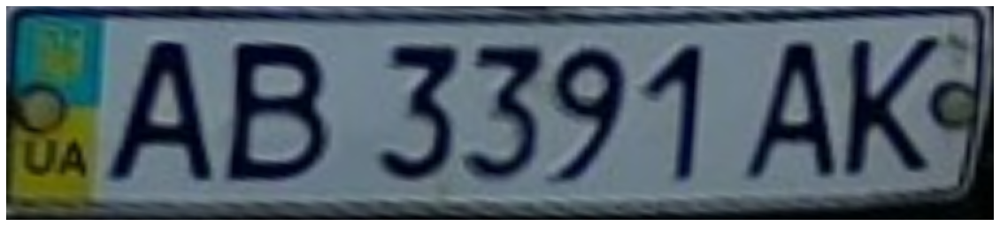

['AB3391AK']


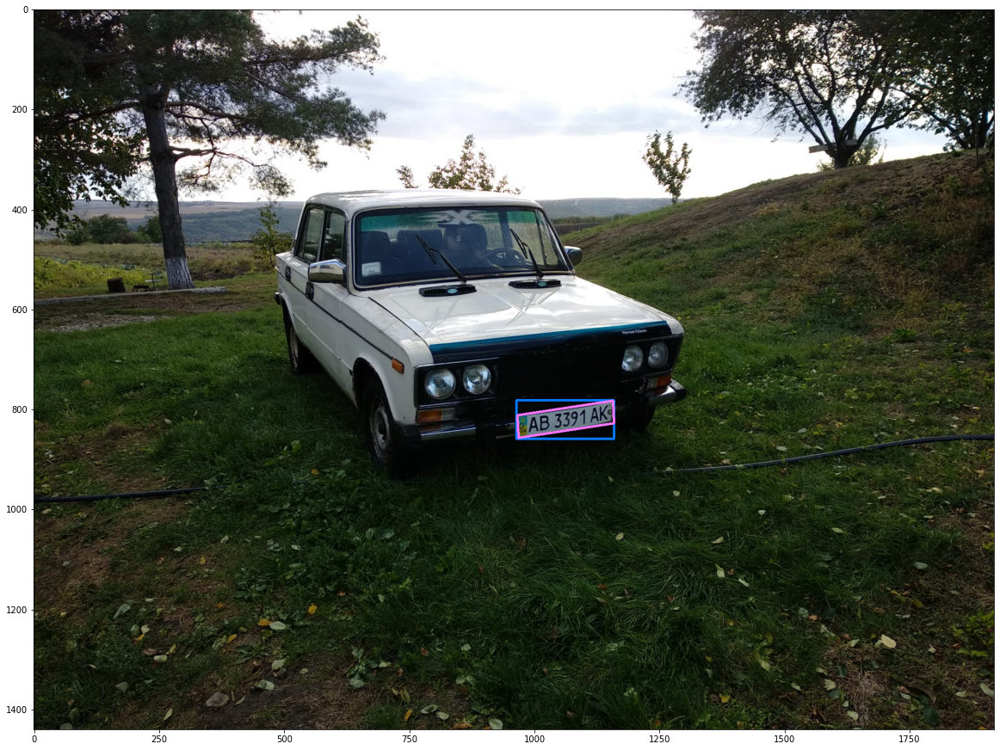

OK: TEXT:AB3391AK 			 RESULTS:['AB3391AK'] 
					 in PATH:./images/9.jpeg
__________ 		 ./images/10.jpeg 		 __________
all_points
[[[1048.7100623282067, 571.3346317341633], [1054.7657816673147, 525.0083517273318], [1161.0278615970449, 482.5035313373375], [1154.9721384345248, 528.8298098632608]]]
['eu_ua_2015']
[1]


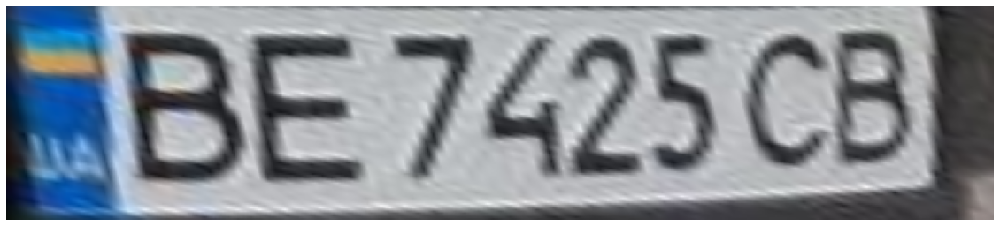

['BE7425CB']


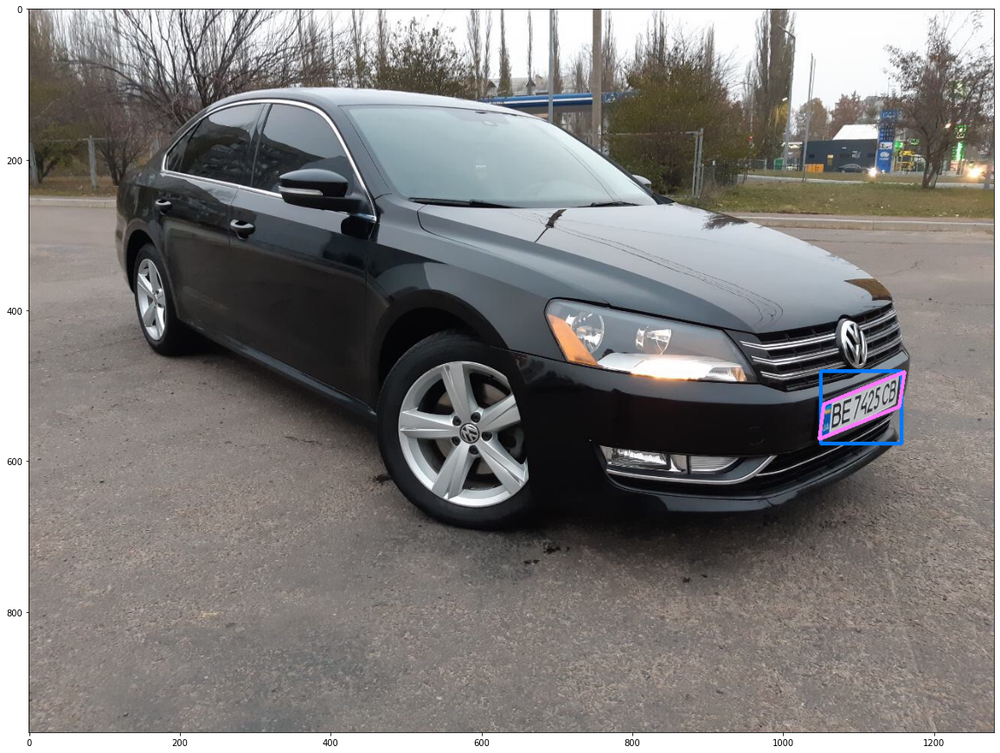

OK: TEXT:BE7425CB 			 RESULTS:['BE7425CB'] 
					 in PATH:./images/10.jpeg
__________ 		 ./images/11.jpeg 		 __________
all_points
[[[1135.7679063941928, 371.5749936359023], [1128.5873689196094, 328.08145934845516], [1209.0326122734182, 290.5403347626839], [1216.2131457832224, 334.03386491382975]]]
['eu_ua_2015']
[1]


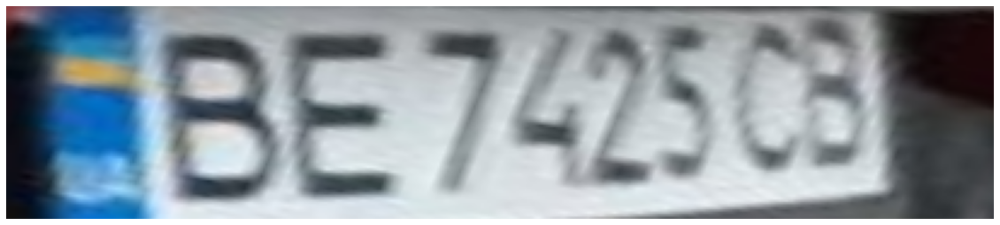

['BE7425CB']


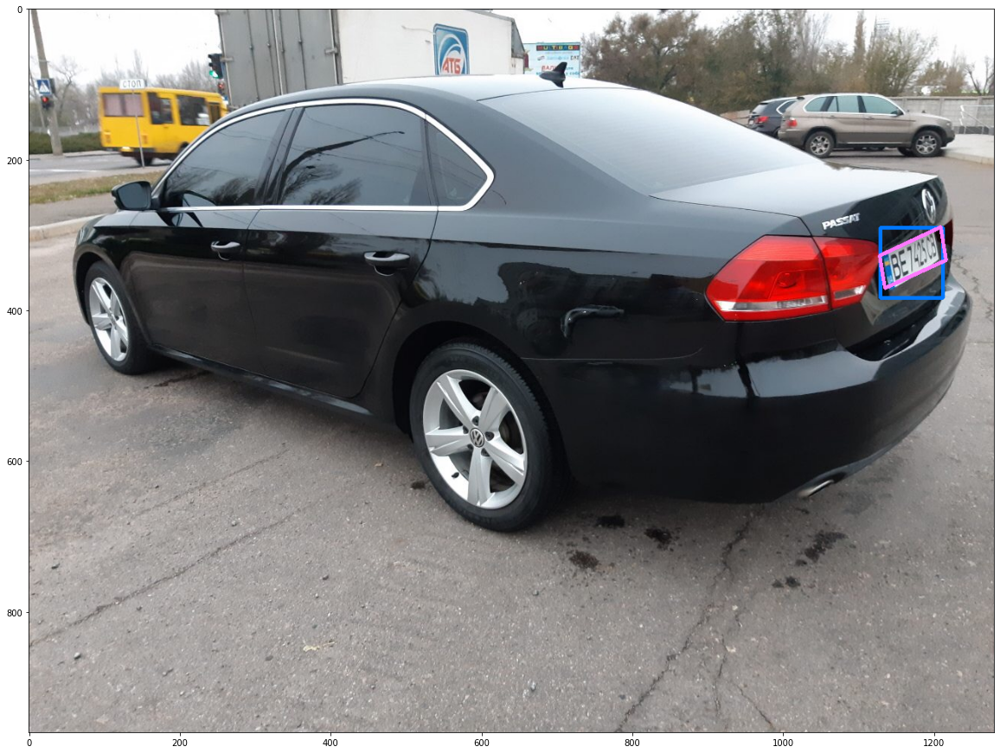

OK: TEXT:BE7425CB 			 RESULTS:['BE7425CB'] 
					 in PATH:./images/11.jpeg
__________ 		 ./images/12.jpeg 		 __________
all_points
[[[51.45210253155048, 368.84882222536515], [46.489640212895324, 337.2131250774531], [120.6982554870312, 379.61804816413303], [125.66071513393108, 411.2537437124398]]]
['su']
[1]


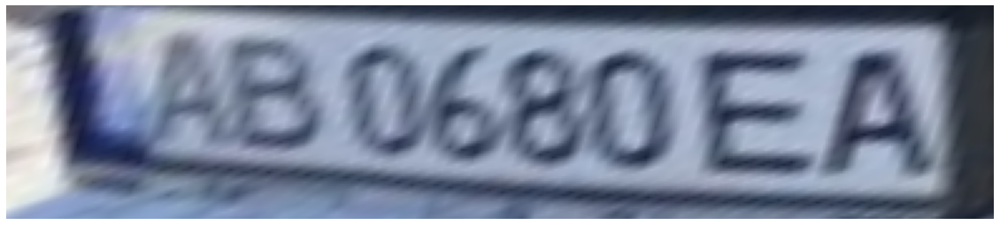

['Х0680ЕА']


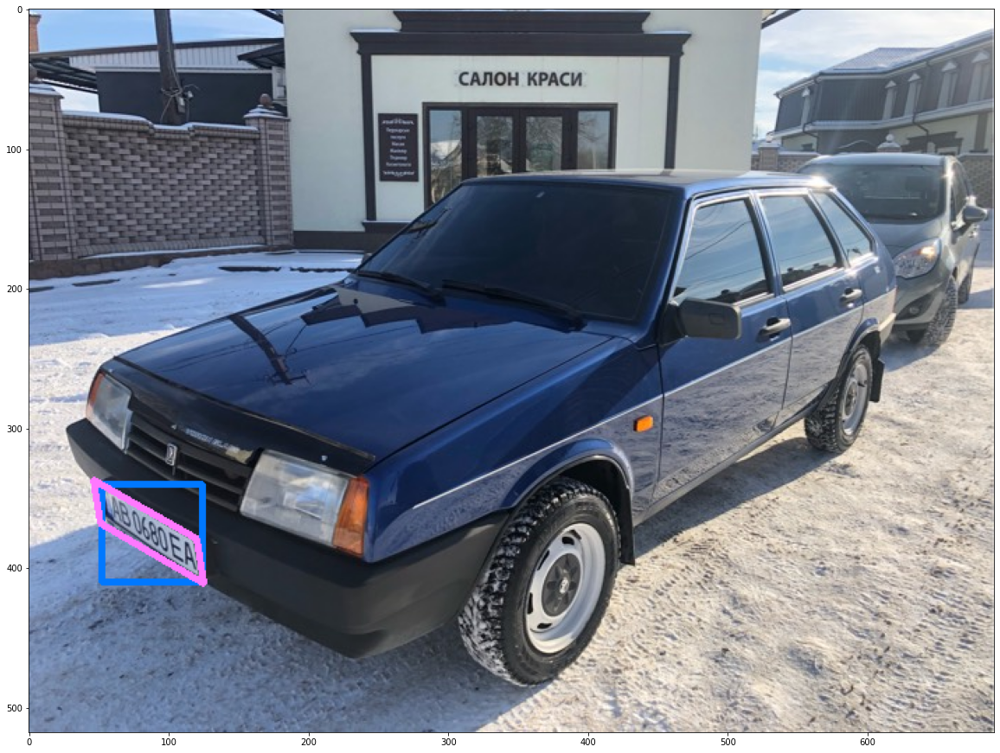

NOT OK: TEXT:AB0680EA 			 RESULTS:['Х0680ЕА'] 
					 in PATH:./images/12.jpeg 
__________ 		 ./images/13.jpeg 		 __________
all_points
[[[137.3810833392762, 422.96813017455725], [135.92072222618413, 394.00653291009854], [271.6189166607238, 431.3235404665746], [273.07927672514904, 460.2851397965422]]]
['eu_ua_2015']
[1]


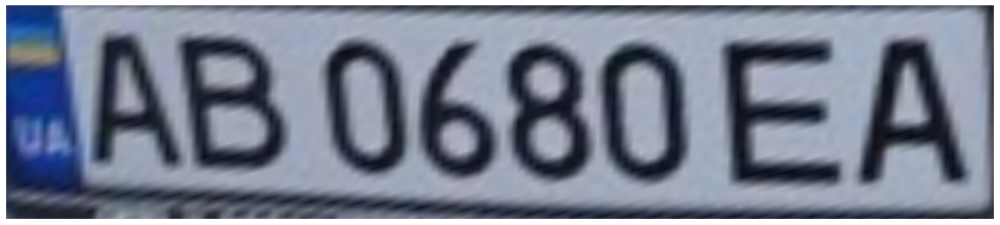

['AB0680EA']


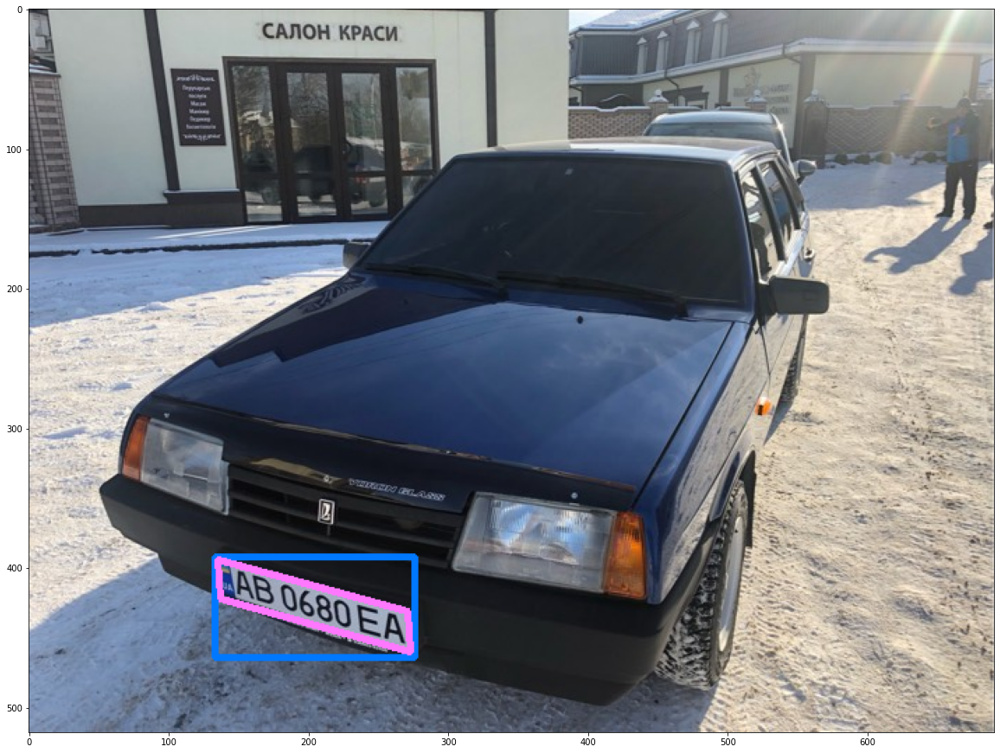

OK: TEXT:AB0680EA 			 RESULTS:['AB0680EA'] 
					 in PATH:./images/13.jpeg
__________ 		 ./images/14.jpeg 		 __________
all_points
[[[167.96746313964803, 825.2680805817595], [166.84319848842057, 776.9057838358045], [419.03253686035197, 791.6321647834308], [420.15680151511515, 839.994462651394]], [[102.0, 401.133332939148], [102.0, 392.86666682243344], [144.0, 392.86666682243344], [144.0, 401.133332939148]]]
['eu_ua_2015', 'xx_unknown']
[1, 0]


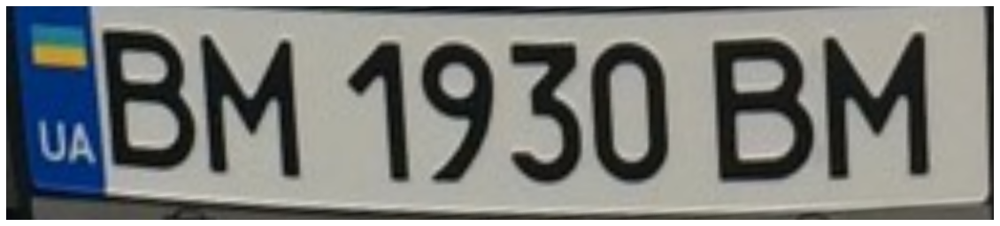

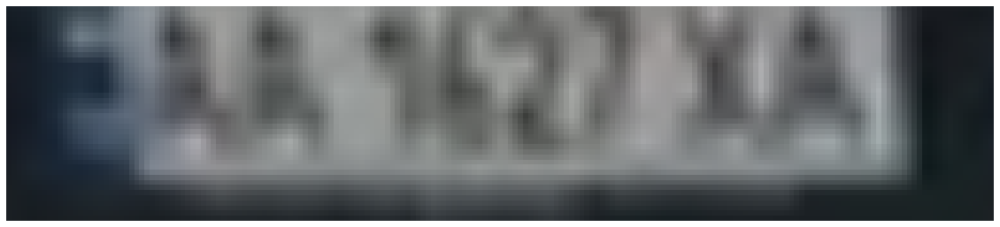

['BM1930BM', '']


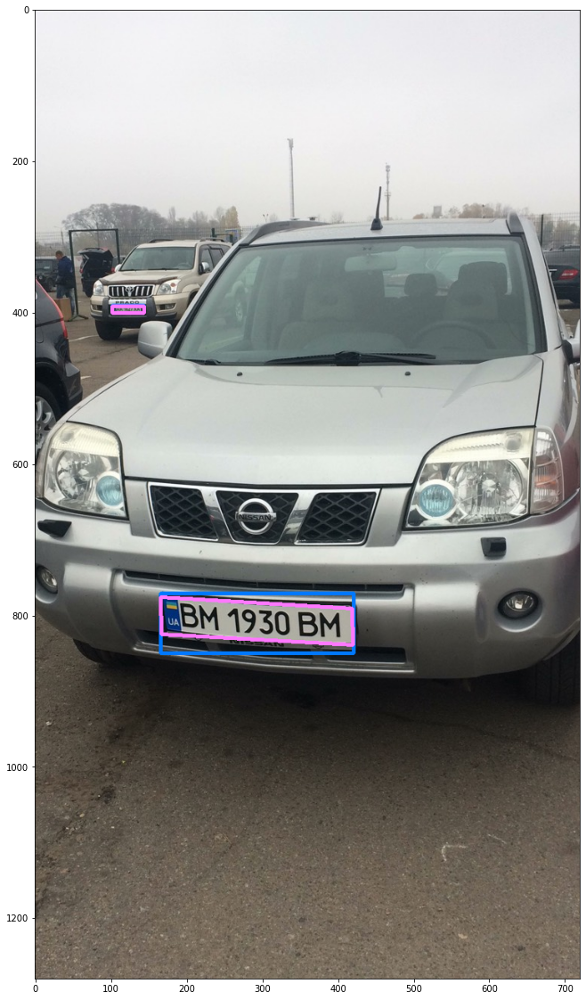

OK: TEXT:BM1930BM 			 RESULTS:['BM1930BM', ''] 
					 in PATH:./images/14.jpeg
__________ 		 ./images/15.jpeg 		 __________
all_points
[[[626.8009308416555, 993.643536372524], [624.0575417892809, 960.1900880006552], [731.1990691583445, 983.6272959045419], [733.9424603889568, 1017.0807430162622]]]
['eu_ua_2015']
[1]


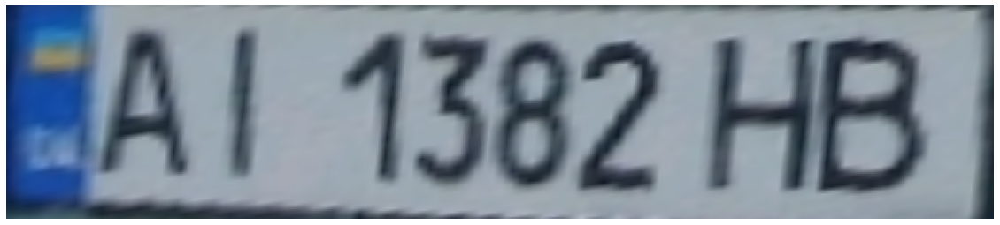

['AI1382HB']


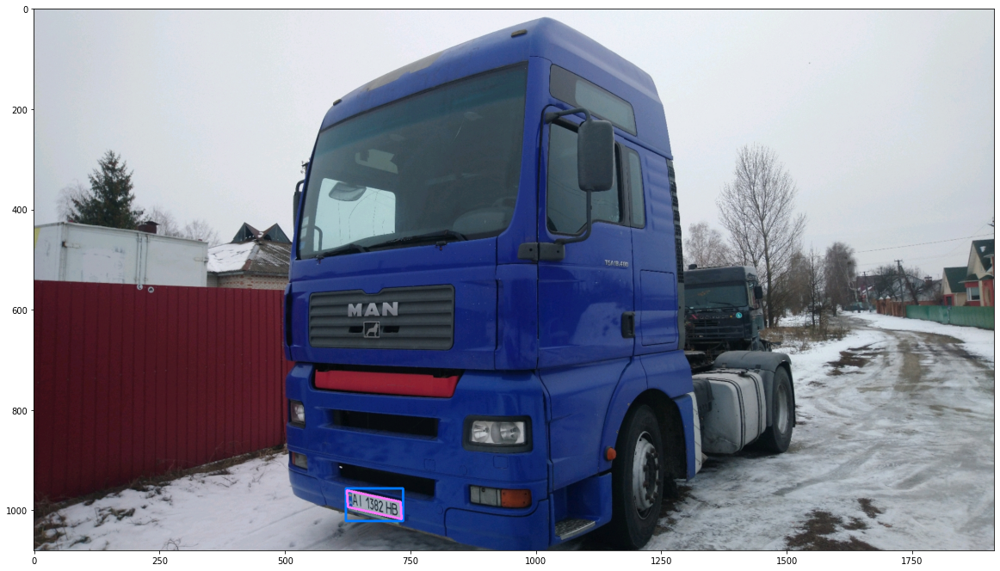

OK: TEXT:AI1382HB 			 RESULTS:['AI1382HB'] 
					 in PATH:./images/15.jpeg
__________ 		 ./images/16.jpeg 		 __________
all_points
[[[1713.2142628582023, 969.2863829136993], [1709.2801489957092, 903.0309137497502], [1845.9300624417829, 859.1077128166797], [1849.86418811556, 925.3631736286468]]]
['eu_ua_2015']
[1]


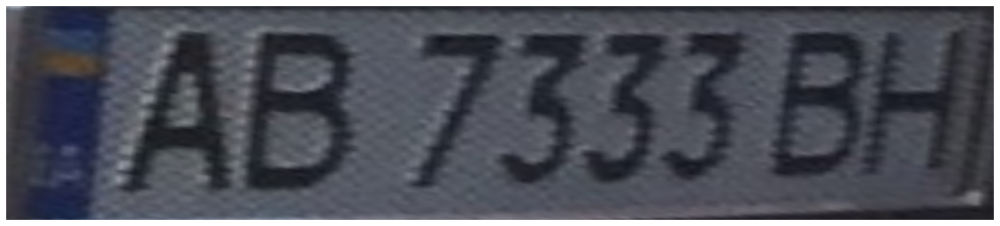

['AB7333BH']


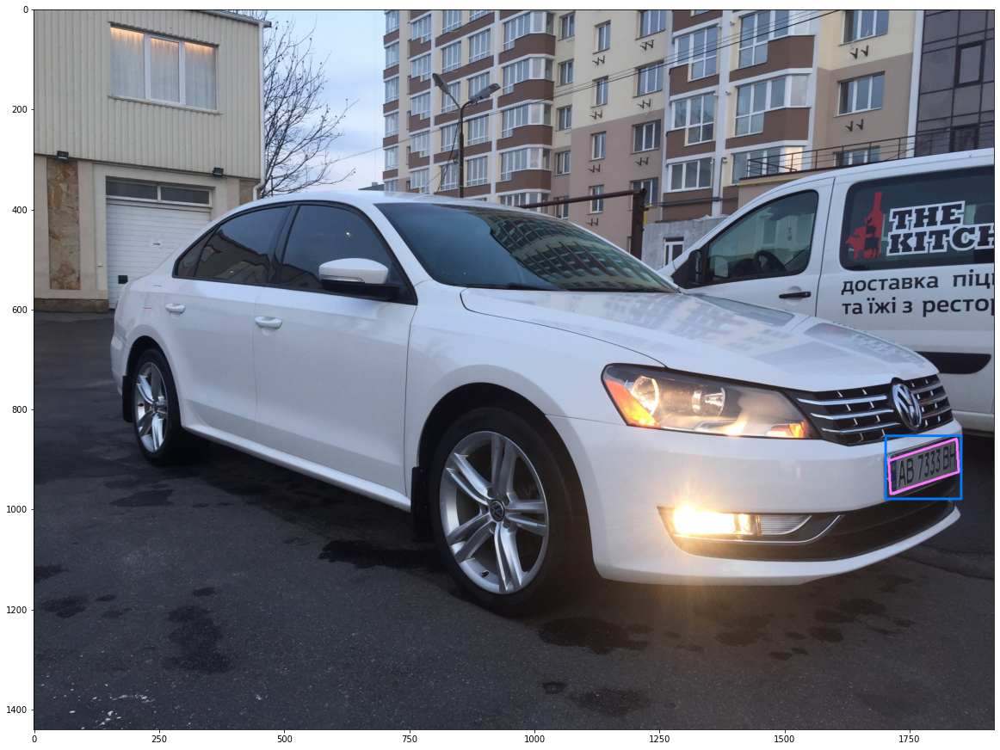

OK: TEXT:AB7333BH 			 RESULTS:['AB7333BH'] 
					 in PATH:./images/16.jpeg
__________ 		 ./images/17.jpeg 		 __________


In [ ]:
testData = {
    "0.jpeg": ["AI5255EI"],
    "1.jpeg": ["AT6883CM"],
    "2.jpeg": ["AT1515CK"],
    "3.jpeg": ["BX0578CE"],
    "4.jpeg": ["AC4249CB"],
    "5.jpeg": ["BC3496HC"],
    "6.jpeg": ["BC3496HC"],
    "7.jpeg": ["AO1306CH"],
    "8.jpeg": ["AE1077CO"],
    "9.jpeg": ["AB3391AK"],
    "10.jpeg": ["BE7425CB"],
    "11.jpeg": ["BE7425CB"],
    "12.jpeg": ["AB0680EA"],
    "13.jpeg": ["AB0680EA"],
    "14.jpeg": ["BM1930BM"],
    "15.jpeg": ["AI1382HB"],
    "16.jpeg": ["AB7333BH"],
    "17.jpeg": ["AB7642CT"],
    "18.jpeg": ["AC4921CB"],
    "19.jpeg": ["BC9911BK"],
    "20.jpeg": ["BC7007AK"],
    "21.jpeg": ["AB5649CI"],
    "22.jpeg": ["AX2756EK"],
    "23.jpeg": ["AA7564MX"],
    "24.jpeg": ["AM5696CK"],
    "25.jpeg": ["AM5696CK"],
}

%matplotlib inline
plt.rcParams["figure.figsize"]  = (20, 20)    

gGood = 0
gBad = 0
i = 0
for fileName in testData.keys():
    nGood, nBad = await test(dirName, fileName, testData[fileName], verbose=1)
    gGood += nGood
    gBad += nBad
    i += 1
total = gGood + gBad
print(f"TOTAL GOOD: {gGood/total}")
print(f"TOTAL BED: {gBad/total}")